# Réalisez une application de recommandation de contenu

L'application est disponible sur Heroku : https://openclassrooms-p9-app-6b76a5f33f7a.herokuapp.com/

Dossier GitHub de l'application de présentation : https://github.com/RashidMall/p9_app/tree/main

Dossier GitHub de l'API : https://github.com/RashidMall/p9_azure_f  

Dossier GitHub du notebook : https://github.com/RashidMall/p9_notebook



## Introduction

My Content, une jeune start-up, se lance dans la création d'une application de recommandation de contenus pour encourager la lecture. En tant que CTO et co-fondateur de cette entreprise, nous sommes en plein développement de notre premier MVP. Pour cela, nous utiliserons des données en ligne, car nous n'avons pas encore de données utilisateurs.  
Notre objectif principal est de fournir à chaque utilisateur une sélection de cinq articles personnalisés.  
Notre mission comprend :
* le développement d'un système de recommandation avec Azure Functions,
* la création d'une interface utilisateur conviviale,
* le stockage des scripts sur GitHub,
* la réflexion sur l'architecture technique et le système de recommandation.  

Nous devrons également envisager une architecture évolutive pour intégrer de nouveaux utilisateurs et articles.

## Problématique

Comment créer une application capable de recommander des articles aux utilisateurs en fonction de leurs préférences, en dépit de l'absence de données initiales sur ces préférences ?  



## Table des matières

1. [Présentation générale du jeu de données](#presentation)  
    1.1 [Chargement des données](#presentation-data)  
    1.2 [Inspection des données](#presentation-inspection)   
2. [Analyse des données](#analyse)  
    2.1 [Valeurs aberrantes](#analyse-outliers)  
    2.2 [Analyse univariée](#analyse-uni)   
    2.3 [Analyse multivariée](#analyse-multi)
3. [Préparation du jeu de données d'étude](#preparation)  
    3.1 [Fusion des données](#preparation-fusion)  
    3.2 [Élaboration d'un indicateur de popularité pour des articles](#preparation-score)   
    3.3 [Séparation du jeu de donnée](#preparation-split)   
4. [Modélisation du système de recommandation](#modelisation)  
    4.1 [Recommandation collaborative](#modelisation-colabo)  
    4.2 [Recommandation basée sur le contenu](#modelisation-content)  
    4.3 [Recommandations pour les nouveaux utilisateurs](#modelisation-new)  
    4.4 [Recommandation collaborative (bibliothèque Surprise)](#modelisation-surprise)   
5. [Mise à jour des bases de données](#updatedata)  
    5.1 [Gestion des articles](#update-articles)  
    5.2 [Gestion des utilisateurs](#update-users)   
6. [Synthèse](#synthese)  

# Importation des librairies Python spécialisées

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import pickle
import os, zipfile, time
import warnings
import random
from sklearn.model_selection import train_test_split as sk_train_test_split
from scipy.sparse import csr_matrix, save_npz

In [ ]:
from surprise import SVDpp
from surprise import Dataset
from surprise import Reader
from surprise import SVD
from surprise import KNNBasic
from surprise import CoClustering
from surprise import BaselineOnly
from surprise import accuracy
from surprise.model_selection import train_test_split
from surprise.model_selection import cross_validate

from implicit.als import AlternatingLeastSquares
from implicit.bpr import BayesianPersonalizedRanking
from implicit.lmf import LogisticMatrixFactorization
from implicit.evaluation import precision_at_k, mean_average_precision_at_k, ndcg_at_k

from sklearn.metrics.pairwise import cosine_similarity

/usr/local/lib/python3.10/dist-packages/implicit/gpu/__init__.py:13: UserWarning: CUDA extension is built, but disabling GPU support because of 'Cuda Error: CUDA driver version is insufficient for CUDA runtime version (/project/./implicit/gpu/utils.h:71)'
  warnings.warn(


# Fonctions

## Cleaning

In [ ]:
def convert_columns_to_integer(data, column_names):
    """
    Convert specified columns in a DataFrame to integer type.

    Parameters
    ----------
    data (pd.DataFrame): The DataFrame containing the data.
    column_names (list): A list of column names to be converted to integer type.

    Returns
    -------
    pd.DataFrame: A new DataFrame with the specified columns converted to integer type.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    data_copy = data.copy()

    # Convert specified columns to integer type
    for column_name in column_names:
        data_copy[column_name] = data_copy[column_name].astype(int)

    return data_copy

In [ ]:
def convert_columns_to_categorical(data, column_names):
    """
    Convert specified columns in a DataFrame to categorical type.

    Parameters
    ----------
    data (pd.DataFrame): The DataFrame containing the data.
    column_names (list): A list of column names to be converted to categorical type.

    Returns
    -------
    pd.DataFrame: A new DataFrame with the specified columns converted to categorical type.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    data_copy = data.copy()

    # Convert specified columns to categorical type
    for column_name in column_names:
        data_copy[column_name] = data_copy[column_name].astype('category')

    return data_copy

## Evaluation

In [ ]:
def add_evaluation_scores(model_name, predictions, df):
    """
    Add RMSE, MSE, and MAE scores to the evaluation results DataFrame.

    Parameters
    -----------
    model_name : str
        The name of the model used for predictions.
    predictions : array-like
        The predicted values.
    df : pd.DataFrame
        The evaluation results DataFrame.

    Returns
    --------
    pd.DataFrame
        The updated evaluation results DataFrame.
    """
    rmse = accuracy.rmse(predictions, verbose=False)
    mse = accuracy.mse(predictions, verbose=False)
    mae = accuracy.mae(predictions, verbose=False)

    # Append the results to the DataFrame
    df = df.append({'model': model_name, 'rmse': rmse, 'mse': mse, 'mae': mae}, ignore_index=True)

    return df

In [ ]:
def evaluate_model_and_append_to_df(model, csr_train, csr_test, model_name, df_cb_evaluation_results):
    """
    Evaluate a model's performance and append the results to a DataFrame.

    Parameters
    -----------
    model: object
        The model to be evaluated.
    csr_train: sparse matrix
        The training data in compressed sparse row format.
    csr_test: sparse matrix
        The test data in compressed sparse row format.
    model_name: str
        The name of the model.
    df_cb_evaluation_results: pd.DataFrame
        The DataFrame to which evaluation results will be appended.

    Returns
    --------
    df_cb_evaluation_results
    """
    precision = round(precision_at_k(model, csr_train, csr_test, K=5, show_progress=True, num_threads=1), 5)
    map_score = round(mean_average_precision_at_k(model, csr_train, csr_test, K=5, show_progress=True, num_threads=1), 5)
    ndcg = round(ndcg_at_k(model, csr_train, csr_test, K=5, show_progress=True, num_threads=1), 5)

    df_cb_evaluation_results = df_cb_evaluation_results.append({
        'model': model_name,
        'precision': precision,
        'map': map_score,
        'ndcg': ndcg,
    }, ignore_index=True)

    return df_cb_evaluation_results

In [ ]:
def calculate_user_recommendation_similarity(model, df, csr_train, num_recommendations=5, max_users=None):
    """
    Calculate user-article recommendation similarity using embeddings and cosine similarity.

    Parameters
    -----------
    model: object
        The collaborative filtering model used for making recommendations.
    df: pandas.DataFrame
        The DataFrame containing user-article interaction data.
    csr_train: scipy.sparse.csr.csr_matrix
        The training set in CSR format.
    num_recommendations: int, optional
        The number of article recommendations to generate for each user (default is 5).
    max_users: int, optional
        Maximum number of users to consider for recommendation calculation (default is None).

    Returns
    --------
    float
        Overall mean cosine similarity between viewed articles and recommended articles.
    pandas.DataFrame
        DataFrame with user recommendations and their cosine similarity scores.
    """
    # For each user, get the IDs of the viewed articles
    user_articles = df.groupby('user_id')['click_article_id'].apply(list).reset_index(name='viewed_articles')

    # Remove users with only one article viewed
    user_articles = user_articles[user_articles.viewed_articles.map(len) > 1]

    # Crop selection if specified
    if max_users is not None:
        user_articles = user_articles[:max_users]

    # For each user, compute the mean embedding vectors of the viewed articles
    user_articles['viewed_mean_embedding'] = user_articles.apply(
        lambda x: articles_embeddings[np.array(x[1])].mean(axis=0), axis=1
    )

    # For each user, make recommendations
    user_ids = user_articles['user_id'].values
    recommended_article_ids, scores = model.recommend(user_ids, csr_train[user_ids], N=num_recommendations, filter_already_liked_items=True)
    user_articles['recommended_articles'] = list(recommended_article_ids)

    # For each user, compute the mean embedding vectors of the recommended articles
    user_articles['recommended_mean_embedding'] = user_articles['recommended_articles'].apply(
        lambda x: articles_embeddings[np.array(x)].mean(axis=0)
    )

    # For each user, compute the cosine similarity between the mean_embedding and the pred_mean_embedding
    user_articles['cos_similarity'] = user_articles.apply(
        lambda x: cosine_similarity(x['viewed_mean_embedding'].reshape(1, -1), x['recommended_mean_embedding'].reshape(1, -1))[0][0],
        axis=1
    )

    # Reset the index column
    user_articles = user_articles.set_index('user_id')

    # Compute & return the overall mean cosine similarity
    return user_articles['cos_similarity'].mean(), user_articles

## Filter

In [ ]:
def get_columns_by_type(df, dtype):
    """
    This function takes a Pandas dataframe and a data type as input,
    and returns the names of the columns that have the specified data type.
    """
    return df.select_dtypes(include=[dtype]).columns.tolist()

In [ ]:
def get_most_recent_article_per_user(df):
    """
    Get the most recent article clicked by each user.

    Parameters
    ----------
    df : pd.DataFrame
        The DataFrame containing user-article interaction data.

    Returns
    -------
    pd.DataFrame
        A DataFrame with 'user_id' and 'article_id' columns representing the most recent article clicked by each user.
    """
    most_recent_article_per_user = df.groupby('user_id').click_timestamp.max().reset_index()
    most_recent_article_per_user = most_recent_article_per_user.merge(df, on=['user_id', 'click_timestamp'], how='left')
    most_recent_article_per_user = most_recent_article_per_user[['user_id', 'click_article_id']]
    most_recent_article_per_user.columns = ['user_id', 'article_id']

    return most_recent_article_per_user

In [ ]:
def get_most_recent_articles_for_user(df, user_id, n=1):
    """
    Get the n most recent articles clicked by a specific user.

    Parameters
    ----------
    df : pd.DataFrame
        The DataFrame containing user-article interaction data.
    user_id : int
        The ID of the user for whom recent articles are retrieved.
    n : int, optional
        The number of most recent articles to retrieve (default is 1).

    Returns
    -------
    pd.Series
        A Series with the most recent article IDs for the user.
    """
    user_articles = df[df.user_id == user_id]
    most_recent_articles = user_articles.nlargest(n, 'click_timestamp')['click_article_id']

    return most_recent_articles

In [ ]:
def get_unseen_articles(article_metadata, clicks, n=5):
    """
    Get n random article IDs from article metadata that are not included in the clicks DataFrame.

    Parameters
    ----------
    article_metadata: pd.DataFrame
        DataFrame containing article metadata.
    clicks: pd.DataFrame
        DataFrame containing user-article interaction data.
    n: int, optional
        The number of random unseen article IDs to return (default is 5).

    Returns
    -------
    pd.Series
        A Series with n random article IDs not present in the clicks DataFrame.
    """
    seen_articles = clicks['click_article_id'].unique()
    unseen_articles = article_metadata[~article_metadata['article_id'].isin(seen_articles)]['article_id']

    if len(unseen_articles) < n:
        return unseen_articles
    else:
        return pd.Series(random.sample(unseen_articles.tolist(), n))

## Graph

In [ ]:
def boxplot_columns(data, columns, figsize=(15, 6), x=""):
    """
    Create a set of boxplots for specified columns in a DataFrame.

    Parameters
    ----------
    data (pd.DataFrame): The DataFrame containing the data.
    columns (list): A list of column names to create boxplots for.
    figsize (tuple, optional): A tuple specifying the figure size (width, height). Default is (15, 6).
    x (str, optional): The column name for the x-axis, if needed. Default is an empty string.

    Returns
    -------
    None
    """
    n_rows = (len(columns) + 2) // 3  # Calculate the number of rows required for subplots
    plt.figure(figsize=figsize)

    for index, col in enumerate(columns, start=1):
        plt.subplot(n_rows, 3, index)
        sns.boxplot(x=data[col])
        plt.xlabel(x)
        plt.title(f"Boxplot for {col}")

    plt.show()

In [ ]:
def plot_histogram(df, quantitative_column, bins=10, x_title="Value"):
    """
    Create a histogram chart for a quantitative column in a Pandas DataFrame using Plotly.

    Parameters
    ----------
    df (pd.DataFrame): The DataFrame containing the quantitative column.
    quantitative_column (str): The name of the quantitative column in the DataFrame.
    bins (int): The number of bins for the histogram.
    x_title (str): The title for the x-axis.

    Returns
    -------
    None
    """
    title = f"Histogram for {quantitative_column}"

    # Create the histogram chart using Plotly
    fig = go.Figure(data=[go.Histogram(x=df[quantitative_column], nbinsx=bins, histnorm='percent')])
    fig.update_layout(
        title=title,
        xaxis_title=x_title,
        yaxis_title="%",
        width=800,
        height=600
    )
    fig.show()

In [ ]:
def plot_timestamp_chart(df, timestamp_column, title="Timestamp Chart"):
    """
    Create a chronological chart of a timestamp column in a Pandas DataFrame using Plotly, grouped by month and year.

    Parameters
    ----------
    df (pd.DataFrame): The DataFrame containing the timestamp column.
    timestamp_column (str): The name of the timestamp column in the DataFrame.
    title (str): The title for the chart.

    Returns
    -------
    None
    """
    # Convert integer timestamp values to datetime format
    df['formatted_timestamp'] = pd.to_datetime(df[timestamp_column], unit='ms')

    # Extract the year and month from datetime values
    df['year'] = df['formatted_timestamp'].dt.year
    df['month'] = df['formatted_timestamp'].dt.strftime('%B %Y')

    # Calculate the count of timestamps by month and year
    monthly_counts = df['month'].value_counts().sort_index()

    # Calculate the total count of timestamps
    total_count = len(df)

    # Calculate the percentages
    percentages = (monthly_counts / total_count) * 100

    # Sort the data chronologically by year and month
    df = df.sort_values(by=['year', 'formatted_timestamp'])

    # Create a bar chart using Plotly
    fig = go.Figure(data=[go.Bar(
        x=df['month'],
        y=percentages,
    )])

    fig.update_layout(
        title=title,
        xaxis_title='Date (Month Year)',
        yaxis_title='Percentage',
        width=800,
        height=600
    )

    fig.show()

In [ ]:
def plot_timestamp_chart_day_format(df, timestamp_column, title="Timestamp Chart"):
    """
    Create a chronological chart of a timestamp column in a Pandas DataFrame using Plotly.

    Parameters
    ----------
    df (pd.DataFrame): The DataFrame containing the timestamp column.
    timestamp_column (str): The name of the timestamp column in the DataFrame.
    title (str): The title for the chart.

    Returns
    -------
    None
    """
    # Convert integer timestamp values to datetime format
    df['formatted_timestamp'] = pd.to_datetime(df[timestamp_column], unit='ms')

    # Convert datetime values to 'day month year' format
    df['formatted_timestamp'] = df['formatted_timestamp'].dt.strftime('%d %B %Y')

    # Sort the data chronologically
    df = df.sort_values(by='formatted_timestamp')

    # Create a bar chart using Plotly
    fig = go.Figure(data=[go.Bar(
        x=df['formatted_timestamp'].value_counts().sort_index().index,
        y=df['formatted_timestamp'].value_counts().sort_index(),
    )])

    fig.update_layout(
        title=title,
        xaxis_title='Date (Day Month Year)',
        yaxis_title='Count',
        width=800,
        height=600
    )

    fig.show()

In [ ]:
def categorical_column_distribution_chart(df, category_column, top=0, without_dups_col="", x_title="Category", title=""):
    """
    Creates a bar chart of the top X classes of a categorical column in a Pandas DataFrame using Plotly.

    Parameters:
    -----------
    df : pandas.DataFrame
        The DataFrame containing the categorical column.
    category_column : str
        The name of the categorical column in the DataFrame.
    top : int
        The number of top categories to display in the chart. If 0, all categories will be displayed.
    without_dups_col : list
        The name of the column to drop duplicates on.

    Returns:
    --------
    None
    """
    if without_dups_col:
        df = df.drop_duplicates(without_dups_col + [category_column])

    # Count the frequency of each class in the categorical column and calculate the percentages
    category_counts = df[category_column].value_counts(normalize=True) * 100
    top_categories = category_counts

    title = title if title else f"Bar chart of {category_column} categories"

    if top > 0:
        # Select the top `top` classes
        top_categories = category_counts[:top]
        title = f"Bar chart of top {top} {category_column} categories"

    # Create the bar chart using Plotly
    fig = go.Figure([go.Bar(x=top_categories.index, y=top_categories.values)])
    fig.update_layout(
        title=title,
        xaxis_title=x_title,
        yaxis_title="Percentage",
        width=800,
        height=600
    )
    fig.update_traces(text=top_categories.values.round(2), textposition='outside')
    fig.show()

In [ ]:
def plot_user_article_distribution(data):
    """
    Create a bar chart displaying the distribution of users by the number of articles they have read using Plotly.

    Parameters
    -----------
    data : pandas.DataFrame
        The DataFrame containing user-article interaction data.

    Returns
    --------
    None
    """
    # Group the data by 'user_id' and calculate the count of articles read by each user
    user_article_counts = data[['user_id','click_article_id']].copy()
    user_article_counts = pd.DataFrame(user_article_counts.groupby('user_id').size(), columns=['num_articles'])
    user_article_counts = pd.DataFrame(user_article_counts.groupby('num_articles').size(), columns=['num_users'])

    user_article_counts["num_users_percent"] = 100 / data['user_id'].nunique() * user_article_counts

    # Create a bar chart using Plotly
    fig = px.bar(user_article_counts, x=user_article_counts.index, y='num_users_percent',
                 labels={'num_users_percent': 'Utilisateurs (%)', 'index': 'Nombre d\'articles lus'},
                 title='Distribution des utilisateurs par nombre d\'articles lus')

    fig.show()

In [ ]:
def plot_article_per_user_distribution(data):
    """
    Create a distribution plot displaying the percentage of articles read and the number of users using Plotly.

    Parameters:
    -----------
    data : pandas.DataFrame
        The DataFrame containing user-article interaction data.

    Returns:
    --------
    None
    """
    # Group the data by 'user_id' and calculate the count of articles read by each user
    user_article_counts = data.groupby('user_id')['click_article_id'].count()

    # Calculate the percentages for articles read
    total_articles = user_article_counts.sum()
    article_percentages = (user_article_counts / total_articles) * 100

    # Create a histogram chart using Plotly
    fig = px.histogram(user_article_counts, x=user_article_counts, y=article_percentages, nbins=50,
                      labels={'x': 'Nombre de lectures'},
                      title='Répartition des articles par nombre de lectures')
    fig.update_layout(yaxis_title='Nombre d\'article lus (%)' )
    fig.show()

In [ ]:
def plot_sns_histogram(df, quantitative_column, bins=10, x_title="Value"):
    """
    Create a histogram chart for a quantitative column in a Pandas DataFrame using Seaborn.

    Parameters
    ----------
    df (pd.DataFrame): The DataFrame containing the quantitative column.
    quantitative_column (str): The name of the quantitative column in the DataFrame.
    bins (int): The number of bins for the histogram.
    x_title (str): The title for the x-axis.

    Returns
    -------
    None
    """
    title = f"Histogram for {quantitative_column}"

    plt.figure(figsize=(8, 6))
    sns.histplot(data=df, x=quantitative_column, stat='percent', bins=bins, kde=True)
    plt.xlabel(x_title)
    plt.ylabel("%")
    plt.title(title)
    plt.show()

## Modify

In [ ]:
def add_mean_cos_similarity(df, model_name, mean_cos_similarity):
    """
    Add the mean_cos_similarity value for a specific model to the DataFrame.

    Parameters
    -----------
    df: pandas.DataFrame
        The DataFrame to which the value will be added.
    model_name: str
        The name of the model.
    mean_cos_similarity: float
        The mean cosine similarity value to be added.

    Returns
    --------
    None
    """
    # Check if the model already exists in the DataFrame
    if model_name in df['model'].values:
        # Update the 'mean_cos_similarity' value for the specific model
        df.loc[df['model'] == model_name, 'mean_cos_similarity'] = mean_cos_similarity
    else:
        # Add a new row for the model with 'mean_cos_similarity'
        df = df.append({'model': model_name, 'mean_cos_similarity': mean_cos_similarity}, ignore_index=True)

In [ ]:
def calculate_mean_embedding(article_ids):
    """
    Calculate the mean embedding for a list of article IDs.

    Parameters
    ----------
    article_ids : list
        A list of article IDs.

    Returns
    -------
    numpy.ndarray
        The mean embedding vector for the provided article IDs.
    """
    mean_embedding = lambda x: articles_embeddings[x].mean(axis=0)
    return mean_embedding(article_ids)

In [ ]:
def add_new_article(df_articles_metadata, new_article_data):
    """
    Add a new article to the df_articles_metadata DataFrame.

    Parameters
    ----------
    df_articles_metadata: pd.DataFrame
        The DataFrame containing article metadata.
    new_article_data: dict
        A dictionary containing the data for the new article, including category_id,
        created_at_ts, publisher_id, and words_count.

    Returns
    -------
    pd.DataFrame
        The updated df_articles_metadata DataFrame with the new article.
    """
    # Calculate the next available article_id by incrementing the maximum article_id in the DataFrame
    next_article_id = df_articles_metadata['article_id'].max() + 1

    # Create a new row with the calculated article_id and provided data
    new_article_row = {
        'article_id': next_article_id,
        'category_id': new_article_data['category_id'],
        'created_at_ts': new_article_data['created_at_ts'],
        'publisher_id': new_article_data['publisher_id'],
        'words_count': new_article_data['words_count']
    }

    # Append the new article data to the DataFrame
    df_articles_metadata = df_articles_metadata.append(new_article_row, ignore_index=True)

    return df_articles_metadata

## Preprocessing

In [ ]:
def calculate_popularity_indicator(df_merged):
    """
    Calculate the popularity indicator for user-article interactions.

    Parameters
    -----------
    df_merged : pd.DataFrame
        The DataFrame containing user-article interaction data.

    Returns
    --------
    pd.DataFrame
        A DataFrame with 'user_id', 'click_article_id', 'user_article_clicks', 'user_total_clicks',
        and 'popularity_indicator' columns.
    """
    # Group the data by user_id and click_article_id to count user-article clicks
    user_article_clicks = df_merged.groupby(['user_id', 'click_article_id'])['click_article_id'].count()

    # Group the data by user_id to count total clicks
    user_total_clicks = df_merged.groupby('user_id')['click_article_id'].count()

    # Create DataFrames from Series
    df_user_article_clicks = user_article_clicks.reset_index(name='user_article_clicks')
    df_user_total_clicks = user_total_clicks.reset_index(name='user_total_clicks')

    # Merge the two DataFrames based on 'user_id'
    df_popularity_ind = pd.merge(df_user_article_clicks, df_user_total_clicks, on='user_id')

    # Calculate the 'popularity_indicator' based on the merged DataFrames
    df_popularity_ind['popularity_indicator'] = df_popularity_ind['user_article_clicks'] / df_popularity_ind['user_total_clicks']

    return df_popularity_ind

In [ ]:
def calculate_category_popularity(df_merged):
    """
    Calculate the category-specific popularity indicator for user-article interactions.

    Parameters
    -----------
    df_merged : pd.DataFrame
        The DataFrame containing user-article interaction data.

    Returns
    --------
    pd.DataFrame
        A DataFrame with 'user_id', 'category_id', 'user_category_clicks', 'user_total_clicks',
        and 'category_popularity' columns.
    """
    # Group the data by user_id and category_id and count the number of category clicks
    user_category_clicks = df_merged.groupby(['user_id', 'category_id'])['category_id'].count()

    # Group the data by user_id and calculate the total clicks
    user_total_clicks = df_merged.groupby('user_id')['click_article_id'].count()

    # Create DataFrames from the Series
    df_user_category_clicks = user_category_clicks.reset_index(name='user_category_clicks')
    df_user_total_clicks = user_total_clicks.reset_index(name='user_total_clicks')

    # Merge the two DataFrames based on 'user_id'
    df_popularity_ind = pd.merge(df_user_category_clicks, df_user_total_clicks, on='user_id')

    # Calculate the 'category_popularity' as the ratio of category-specific clicks to total clicks by the user
    df_popularity_ind['category_popularity'] = df_popularity_ind['user_category_clicks'] / df_popularity_ind['user_total_clicks']

    return df_popularity_ind

## Recommendation

In [ ]:
def recommend_top_articles(model, user_id, num_recommendations=10):
    """
    Recommend the top articles for a given user using a collaborative filtering model.

    Parameters:
    -----------
    model: object
        The collaborative filtering model used for making recommendations.
    user_id: int
        The ID of the user for whom recommendations are generated.
    num_recommendations: int, optional
        The number of article recommendations to return (default is 10).

    Returns:
    --------
    pd.DataFrame
        A DataFrame with 'article_id' and 'score' columns representing the top article recommendations.
    """
    articles_read = df_article_popularity[df_article_popularity.user_id == user_id].click_article_id.unique()
    print("Total articles viewed by the user {}: {}".format(user_id, len(articles_read)))
    articles_not_read = df_articles_metadata[~df_articles_metadata.article_id.isin(articles_read)].article_id.unique()
    print("Total articles not viewed by the user {}: {}".format(user_id, len(articles_not_read)))

    articles_not_read_with_score = [[article_id, model.predict(user_id, article_id).est] for article_id in articles_not_read]
    articles_not_read_with_score_sorted = sorted(articles_not_read_with_score, key=lambda x: x[1], reverse=True)

    top_recommendations = articles_not_read_with_score_sorted[:num_recommendations]
    recommendation_df = pd.DataFrame(top_recommendations, columns=['article_id', 'score'])

    return recommendation_df

In [ ]:
def get_top_popular_articles(df, num_recommendations=10):
    """
    Get the top popular articles based on the popularity indicator.

    Parameters
    -----------
    df: pd.DataFrame
        DataFrame containing user-article interaction data, including 'click_article_id' and 'popularity_indicator' columns.
    num_recommendations: int, optional
        The number of top popular articles to recommend (default is 10).

    Returns
    --------
    pd.DataFrame
        A DataFrame with the top popular articles and their popularity scores.
    """
    # Group the data by 'article_id' and calculate the sum of popularity indicators
    df_popular_articles = df.groupby(by=['click_article_id'])['popularity_indicator'].sum().sort_values(ascending=False).reset_index()

    # Normalize the popularity scores to be between 0 and 1
    df_popular_articles['score'] = df_popular_articles['popularity_indicator'] / df_popular_articles['popularity_indicator'].max()

    # Print a message and create a DataFrame with the top popular articles
    print(f'Top {num_recommendations} popular articles:')
    recommendation = df_popular_articles[['click_article_id', 'score']].head(num_recommendations).to_dict('records')
    recommendation_df = pd.DataFrame(recommendation)
    recommendation_df = recommendation_df.rename(columns={'click_article_id': 'article_id'})

    return recommendation_df


In [ ]:
def recommend_articles_to_users(model, user_ids, csr_matrix, num_recommendations=5):
    """
    Recommend a list of articles to multiple users using a collaborative filtering model.

    Parameters
    -----------
    model: object
        The collaborative filtering model used for making recommendations.
    user_ids: list
        A list of user IDs for whom recommendations are generated.
    csr_matrix: csr_matrix
        The user-article interaction matrix.
    num_recommendations: int, optional
        The number of article recommendations to return for each user (default is 5).

    Returns
    --------
    None
    """
    article_ids, scores = model.recommend(user_ids, csr_matrix[user_ids], N=num_recommendations, filter_already_liked_items=True)

    for i, user_id in enumerate(user_ids):
        print(f"\nRecommended articles for the user {user_id}\n")

        for article_id, score in zip(article_ids[i], scores[i]):
            print(f"article_id: {article_id:10} \t score: {score}")

In [ ]:
# Using mean cosine similarity
def get_content_based_recommendations(user_id, num_recommendations=5, user_history_length=None):
    """
    Get content based article recommendations for a user based on their recent article views.

    Parameters
    ----------
    user_id: int
        The ID of the user for whom recommendations are generated.
    num_recommendations: int, optional
        The number of article recommendations to return (default is 5).
    user_history_length: int, optional
        The number of recent article views to consider (default is None, which includes all views).

    Returns
    -------
    list
        A list of top article recommendations for the user.
    """
    if user_history_length is not None:
        # Get the specified number of most recent article views for the user
        #recent_article_views = df_train[df_train.user_id == user_id]['article_id'].iloc[-user_history_length:]
        recent_article_views = get_most_recent_articles_for_user(df_train, user_id, n=user_history_length)
    else:
        # Get all article views for the user if user_history_length is not specified
        recent_article_views = df_train[df_train.user_id == user_id]['article_id']

    if len(recent_article_views) < 1:
        return []

    # Calculate the mean embedding of the recent article views
    mean_recent_article_views = calculate_mean_embedding(recent_article_views.values)

    # Create a copy of article embeddings and subtract the mean embedding for recent views
    embeddings = articles_embeddings.copy()
    mean_recent_views = mean_recent_article_views
    embeddings[recent_article_views.values] = -mean_recent_views

    # Calculate cosine similarity between modified embeddings and the mean recent views
    cosine = cosine_similarity(embeddings, mean_recent_views.reshape(1, -1))

    # Get top article recommendations based on cosine similarity
    recommendations = get_top_recommendations(cosine, num_recommendations)

    return recommendations


def get_top_recommendations(cosine, num_recommendations=5):
    """
    Get the top cosine similarity recommendations.

    Parameters
    ----------
    cosine: pd.Series
        A Series containing cosine similarity values.
    num_recommendations: int, optional
        The number of recommendations to return (default is 5).

    Returns
    -------
    pd.DataFrame
        A DataFrame with 'article_id' and 'cos_similarity' columns for the top recommendations.
    """
    recommendations = pd.DataFrame(cosine, columns=['cos_similarity'])
    recommendations = recommendations.sort_values('cos_similarity', ascending=False)[:num_recommendations]
    recommendations = recommendations.reset_index()
    recommendations = recommendations.rename(columns={'index': 'article_id'})

    return recommendations

In [ ]:
def recommend_content_based_articles(df, user_id, num_recommendations=5, user_history_length=1):
    """
    Generate recommendations for a user based on their recent article views and unseen articles.

    Parameters
    ----------
    df: pd.DataFrame
        The DataFrame containing user-article interaction data.
    user_id: int
        The user for whom recommendations are generated.
    num_recommendations: int, optional
        The total number of recommendations to return (default is 5).
    user_history_length: int, optional
        The number of most recent article views to consider (default is 1).

    Returns
    -------
    list
        A list of article IDs recommended for the user.
    """
    # Get most recent articles viewed by a user
    if user_history_length is not None:
        recent_article_views = get_most_recent_articles_for_user(df_clicks, user_id, n=user_history_length)
    else:
        recent_article_views = df[df.user_id == user_id]['article_id']

    # Get the specified number of unseen articles
    n_unseen = num_recommendations % 4
    unseen_articles = get_unseen_articles(df_articles_metadata, df_clicks, n=n_unseen)

    # Initialize a dataframe for recommendations
    recommended_articles = pd.DataFrame(columns=('article_id', 'cos_similarity_score'))

    # For each recent article, find similar articles
    for article_id in recent_article_views:
        similar_articles = get_similar_articles(article_id, num_recommendations)
        # Add the selected articles to the recommendations
        recommended_articles = recommended_articles.append(similar_articles)

    # Randomly select a subset of similar articles
    random_selection = recommended_articles.sample(num_recommendations - n_unseen, replace=True)
    # Loop to add unseen article IDs to the DataFrame
    for article_id in unseen_articles:
        random_selection = random_selection.append({'article_id': article_id, 'cos_similarity_score': 0}, ignore_index=True)

    return random_selection



def get_similar_articles(article_id, n=5):
    """
    Get the most similar articles to a given article.

    Parameters
    ----------
    article_id : int
        The article ID for which to find similar articles.
    n : int, optional
        Number of similar articles to retrieve (default is 5).

    Returns
    -------
    pd.DataFrame
        A DataFrame with columns 'article_id' and 'cos_similarity_score' representing similar articles.
    """
    # Filter embeddings to remove unseen articles
    filtered_embeddings = filter_embeddings(articles_embeddings)

    # Get the index of the article in the embeddings
    idx = filtered_embeddings.index.get_loc(article_id)

    # Calculate the cosine similarity between the article and all other articles
    cos_similarity = cosine_similarity(filtered_embeddings, filtered_embeddings)

    # Get the similarity scores of the article with other articles
    similarity_scores = list(enumerate(cos_similarity[idx]))

    # Sort the similarity scores in descending order
    similarity_scores = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

    # Get the n most similar articles
    similarity_scores = similarity_scores[1:n + 1]

    # Get the indices of the similar articles
    articles_index = [i[0] for i in similarity_scores]

    # Get the article IDs and their corresponding similarity scores
    article_ids, cos_similarity_scores = filtered_embeddings.iloc[articles_index].index, [i[1] for i in similarity_scores]

    # Create a DataFrame with similar articles and their similarity scores
    df_recommended_articles = pd.DataFrame({
        'article_id': article_ids,
        'cos_similarity_score': cos_similarity_scores
    })

    return df_recommended_articles


def filter_embeddings(embeddings):
    """
    Filter embeddings to only include those corresponding to viewed articles.

    Parameters
    ----------
    embeddings: pd.DataFrame
        DataFrame containing embeddings for all articles.

    Returns
    -------
    pd.DataFrame
        Filtered embeddings containing only those corresponding to viewed articles.
    """
    embeddings = pd.DataFrame(embeddings)
    viewed_articles = df_clicks['click_article_id'].value_counts().index

    return embeddings.iloc[viewed_articles]

# Config

In [ ]:
warnings.filterwarnings('ignore')

# 1. Présentation générale du jeu de données <a name="presentation"></a>

Le jeu de données contient un échantillon des interactions des utilisateurs (consultations de pages) sur le portail d'actualités G1 du 1er au 16 octobre 2017. Il comprend environ 3 millions de clics répartis dans plus d'un million de sessions, impliquant 314 000 utilisateurs ayant consulté plus de 46 000 articles d'actualités différents pendant cette période.

Il se compose de trois fichiers/dossiers :

* `clicks.zip` - Un dossier avec des fichiers CSV (un par heure) contenant les interactions des utilisateurs lors de leurs sessions sur le portail d'actualités.  
* `articles_metadata.csv` - Un fichier CSV contenant des informations sur les métadonnées de tous les articles publiés (364 047 au total).  
* `articles_embeddings.pickle` - Un fichier au format Pickle (Python 3) contenant une matrice NumPy avec les représentations d'incorporation du contenu des articles (vecteurs de 250 dimensions). Ces vecteurs ont été créés en utilisant le module ACR de CHAMELEON, en se basant sur le texte et les métadonnées des articles, et couvrent les 364 047 articles publiés.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 1.1. Chargement des données <a name="presentation-data"></a>

In [ ]:
# Uploading data in Google Colab
zip_data = zipfile.ZipFile('/content/drive/MyDrive/globocom_data.zip', 'r')
zip_data.extractall('/tmp')
zip_data.close()

In [ ]:
zip_data = zipfile.ZipFile('../tmp/clicks.zip', 'r')
zip_data.extractall('/tmp')
zip_data.close()

In [ ]:
df_articles_metadata = pd.read_csv('../tmp/articles_metadata.csv')

with open('../tmp/articles_embeddings.pickle', 'rb') as file:
  articles_embeddings = pickle.load(file)

datalist = []
for i in range(0, 385):
    data_tmp = pd.read_csv(f'../tmp/clicks/clicks_hour_{i:03}.csv')
    data_tmp['hour'] =  i
    datalist.append(data_tmp)

df_clicks = pd.concat(datalist)

## 1.2. Inspection des données <a name="presentation-inspection"></a>

### Métadonnées

Ce jeu de données est composé de 364 047 lignes décrites par 5 variables

|Variable|Description|
|--------|-----------|
|__article_id__ | identifiant d'un article|
|__category_id__ | identifiant d'une catégorie|
| __created_at_ts__ | horodatage (en millisecondes) lorsque l'article a été créé|
| __publisher_id__ | identifiant de l'éditeur|
| __words_count__ | nombre de mots dans un article|

In [ ]:
df_articles_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 364047 entries, 0 to 364046
Data columns (total 5 columns):
 #   Column         Non-Null Count   Dtype
---  ------         --------------   -----
 0   article_id     364047 non-null  int64
 1   category_id    364047 non-null  int64
 2   created_at_ts  364047 non-null  int64
 3   publisher_id   364047 non-null  int64
 4   words_count    364047 non-null  int64
dtypes: int64(5)
memory usage: 13.9 MB


In [ ]:
df_articles_metadata.head()

,article_id,category_id,created_at_ts,publisher_id,words_count
0,0,0,1513144419000,0,168
1,1,1,1405341936000,0,189
2,2,1,1408667706000,0,250
3,3,1,1408468313000,0,230
4,4,1,1407071171000,0,162


In [ ]:
df_articles_metadata.tail()

,article_id,category_id,created_at_ts,publisher_id,words_count
364042,364042,460,1434034118000,0,144
364043,364043,460,1434148472000,0,463
364044,364044,460,1457974279000,0,177
364045,364045,460,1515964737000,0,126
364046,364046,460,1505811330000,0,479


In [ ]:
df_articles_metadata.describe()

,article_id,category_id,created_at_ts,publisher_id,words_count
count,364047.000000,364047.000000,3.640470e+05,364047.0,364047.000000
mean,182023.000000,283.108239,1.474070e+12,0.0,190.897727
std,105091.461061,136.723470,4.293038e+10,0.0,59.502766
min,0.000000,0.000000,1.159356e+12,0.0,0.000000
25%,91011.500000,199.000000,1.444925e+12,0.0,159.000000
50%,182023.000000,301.000000,1.489422e+12,0.0,186.000000
75%,273034.500000,399.000000,1.509891e+12,0.0,218.000000
max,364046.000000,460.000000,1.520943e+12,0.0,6690.000000


Vérifions s'il existe des doublons.

In [ ]:
df_articles_metadata.duplicated(subset=['article_id']).sum()

0

In [ ]:
print("Le nombre total des articles :", df_articles_metadata['article_id'].nunique())
print("Le nombre total des catégories :", df_articles_metadata['category_id'].nunique())
print("Le nombre total des éditeurs :", df_articles_metadata['publisher_id'].nunique())

Le nombre total des articles : 364047
Le nombre total des catégories : 461
Le nombre total des éditeurs : 1


### Les clics

Ce jeu de données est composé de 2 988 181 lignes décrites par 13 variables

|Variable|Description|
|--------|-----------|
|__user_id__ | identifiant d'utilisateur|
|__session_id__ | identifiant d'une session|
| __session_start__ | date de début de la session|
| __session_size__ | nombre d'articles vus pendant la session|
| __click_article_id__ | identifiant d'article sur lequel on a cliqué|
| __click_timestamp__ | identifiant d'article sur lequel on a cliqué|
| __click_environment__ | environnement ou plate-forme où l'événement de clic s'est produit|
| __click_deviceGroup__ | type d'appareil ou de plate-forme qu'un utilisateur utilise|
| __click_os__ | identifiant du système d'exploitation|
| __click_country__ | pays de l'utilisateur|
| __click_region__ | région de l'utilisateur|
| __click_referrer_type__ | type de site de provenance|
| __hour__ | durée de la session en heures|

`click_environment`:
1. Facebook
2. Mobile App
3. Mobile Pages
4. Web  

`click_deviceGroup`:
1. Tablet  
2. TV  
4. Mobile
5. Computer
3. blank  

`click_os`:  
1. Other  
2. iOS  
3. Android  
4. Windows Phone  
5. Windows Mobile  
6. Windows  
7. Mac OS X  
8. Mac OS  
9. Samsung  
10. FireHbbTV  
11. ATV OS X  
12. tvOS  
13. Chrome OS  
14. Debian  
15. Symbian OS  
16. BlackBerry OS  
17. Firefox OS  
18. Android  
19. Brew MP  
20. Chromecast  
21. webOS  
22. Gentoo  
23. Solaris

In [ ]:
df_clicks.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2988181 entries, 0 to 2568
Data columns (total 13 columns):
 #   Column               Dtype 
---  ------               ----- 
 0   user_id              object
 1   session_id           object
 2   session_start        object
 3   session_size         object
 4   click_article_id     object
 5   click_timestamp      object
 6   click_environment    object
 7   click_deviceGroup    object
 8   click_os             object
 9   click_country        object
 10  click_region         object
 11  click_referrer_type  object
 12  hour                 int64 
dtypes: int64(1), object(12)
memory usage: 319.2+ MB


In [ ]:
int_cols = ['user_id', 'session_id', 'session_start', 'session_size', 'click_article_id', 'click_timestamp', 'hour']
cat_cols = ['click_environment', 'click_deviceGroup', 'click_os', 'click_country', 'click_region', 'click_referrer_type']

df_clicks = convert_columns_to_integer(df_clicks, int_cols)
df_clicks = convert_columns_to_categorical(df_clicks, cat_cols)

In [ ]:
environment_mapping = {1: "Facebook", 2: "Mobile App", 3: "Mobile Pages", 4: "Web"}
os_mapping = {
    1: "Other",
    2: "iOS",
    3: "Android",
    4: "Windows Phone",
    5: "Windows Mobile",
    6: "Windows",
    7: "Mac OS X",
    8: "Mac OS",
    9: "Samsung",
    10: "FireHbbTV",
    11: "ATV OS X",
    12: "tvOS",
    13: "Chrome OS",
    14: "Debian",
    15: "Symbian OS",
    16: "BlackBerry OS",
    17: "Firefox OS",
    18: "Android",
    19: "Brew MP",
    20: "Chromecast",
    21: "webOS",
    22: "Gentoo",
    23: "Solaris"
}

device_mapping = {
    1: "Tablet",
    2: "TV",
    3: "Mobile",
    4: "Computer",
    5: "blank"
}

df_clicks['click_environment'] = df_clicks['click_environment'].map(environment_mapping)
df_clicks['click_deviceGroup'] = df_clicks['click_deviceGroup'].map(device_mapping)
df_clicks['click_os'] = df_clicks['click_os'].map(os_mapping)

In [ ]:
df_clicks.head()

,user_id,session_id,session_start,session_size,click_article_id,click_timestamp,click_environment,click_deviceGroup,click_os,click_country,click_region,click_referrer_type,hour
0,0,1506825423271737,1506825423000,2,157541,1506826828020,Web,Mobile,Chromecast,1,20,2,0
1,0,1506825423271737,1506825423000,2,68866,1506826858020,Web,Mobile,Chromecast,1,20,2,0
2,1,1506825426267738,1506825426000,2,235840,1506827017951,Web,Tablet,Firefox OS,1,16,2,0
3,1,1506825426267738,1506825426000,2,96663,1506827047951,Web,Tablet,Firefox OS,1,16,2,0
4,2,1506825435299739,1506825435000,2,119592,1506827090575,Web,Tablet,Firefox OS,1,24,2,0


In [ ]:
df_clicks.tail()

,user_id,session_id,session_start,session_size,click_article_id,click_timestamp,click_environment,click_deviceGroup,click_os,click_country,click_region,click_referrer_type,hour
2564,10051,1508211372158328,1508211372000,2,84911,1508211557302,Web,Mobile,iOS,1,25,1,384
2565,322896,1508211376302329,1508211376000,2,30760,1508211672520,Web,Tablet,Firefox OS,1,25,2,384
2566,322896,1508211376302329,1508211376000,2,157507,1508211702520,Web,Tablet,Firefox OS,1,25,2,384
2567,123718,1508211379189330,1508211379000,2,234481,1508211513583,Web,Mobile,iOS,1,25,2,384
2568,123718,1508211379189330,1508211379000,2,233578,1508211543583,Web,Mobile,iOS,1,25,2,384


In [ ]:
df_clicks.describe()

,user_id,session_id,session_start,session_size,click_article_id,click_timestamp,hour
count,2.988181e+06,2.988181e+06,2.988181e+06,2.988181e+06,2.988181e+06,2.988181e+06,2.988181e+06
mean,1.079478e+05,1.507472e+15,1.507472e+12,3.901885e+00,1.949226e+05,1.507474e+12,1.791782e+02
std,8.364836e+04,3.855245e+11,3.855245e+08,3.929941e+00,9.076842e+04,3.858510e+08,1.070914e+02
min,0.000000e+00,1.506825e+15,1.506825e+12,2.000000e+00,3.000000e+00,1.506827e+12,0.000000e+00
25%,4.034100e+04,1.507124e+15,1.507124e+12,2.000000e+00,1.242280e+05,1.507127e+12,8.200000e+01
50%,8.622900e+04,1.507493e+15,1.507493e+12,3.000000e+00,2.023810e+05,1.507495e+12,1.850000e+02
75%,1.632610e+05,1.507749e+15,1.507749e+12,4.000000e+00,2.770670e+05,1.507751e+12,2.560000e+02
max,3.228960e+05,1.508211e+15,1.508211e+12,1.240000e+02,3.640460e+05,1.510603e+12,3.840000e+02


Vérifions s'il existe des doublons.

In [ ]:
df_clicks.duplicated().sum()

0

In [ ]:
print("Le nombre total des utilisateurs :", df_clicks['user_id'].nunique())
print("Le nombre total des sessions :", df_clicks['session_id'].nunique())

Le nombre total des utilisateurs : 322897
Le nombre total des sessions : 1048594


# 2. Analyse des données <a name="analyse"></a>

## 2.1. Valeurs aberrantes <a name="analyse-outliers"></a>

Pour visualiser les outliers représentons les valeurs des variables quantitatives sous forme des boîtes à moustaches.

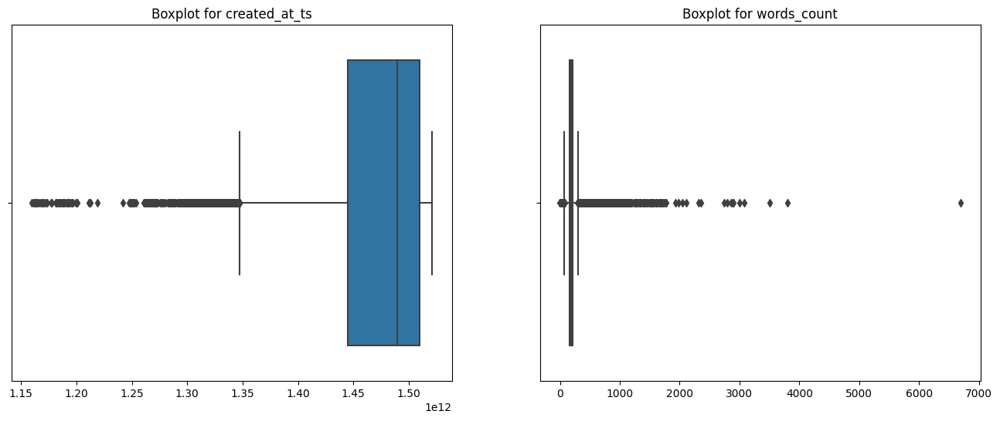

In [ ]:
boxplot_columns(df_articles_metadata, ['created_at_ts', 'words_count'], figsize=(25, 6))

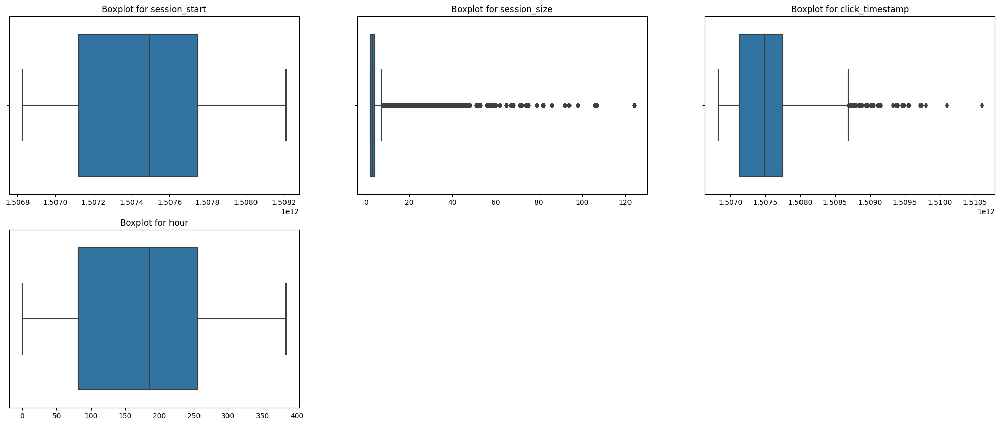

In [ ]:
cols = ['session_start', 'session_size', 'click_timestamp', 'hour']
boxplot_columns(df_clicks, cols, figsize=(25, 10))

Il n'y a pas de valeurs impossibles pour ces variables.

## 2.2. Analyse univariée <a name="analyse-uni"></a>

### Les catégories d'article

In [ ]:
categorical_column_distribution_chart(df_articles_metadata, category_column='category_id', x_title='Catégorie', title="Répartition des catégories par article")

### Date de création d'articles

In [ ]:
plot_timestamp_chart(df_articles_metadata, 'created_at_ts', title="Date de création d'articles")

Les données disponibles vont de septembre 2006 à decembre 2010.

### Nombre de mots dans des articles

In [ ]:
plot_histogram(df_articles_metadata, 'words_count', bins=500, x_title="word")

Le graphique montre la distribution de nombre de mots dans les articles.  
D'après le graphique, la majorité des articles, soit 60 %, contiennent moins de 200 mots.

### Date de début de la session

In [ ]:
plot_timestamp_chart_day_format(df_clicks, 'session_start', title="Date de début de la session")

### Date du clic

In [ ]:
plot_timestamp_chart_day_format(df_clicks, 'click_timestamp', title="Date du clic")

### Durée de la session

In [ ]:
plot_histogram(df_clicks, 'hour', bins=20, x_title="hour")

Le graphique montre la distribution de nombre de mots dans les articles.  
D'après le graphique, la majorité des sessions, soit 80 % ne dépasse pas 280 heures.

### Session size

In [ ]:
plot_histogram(df_clicks, 'session_size', bins=60, x_title="hour")

### Environnement du clic

In [ ]:
categorical_column_distribution_chart(df_clicks, category_column='click_environment', without_dups_col=['session_id'], x_title='Environnement', title="Type d'environnement utilisé dans différentes sessions")

Le graphique présente les environnements variés utilisés lors des sessions.  
Selon les données du graphique, l'environnement le plus fréquemment utilisé est le Web, représentant 96,94 % des cas.

### Type d'appareil utilisé

In [ ]:
categorical_column_distribution_chart(df_clicks, category_column='click_deviceGroup', without_dups_col=['session_id'], x_title='Appareil', title="Divers appareils utilisés lors des sessions")

Le graphique présente les variétés d'appareils utilisés au cours des sessions.   
Les tablettes sont utilisées dans 57,64 % des cas, suivies par les smartphones à 38,31 %, tandis que les ordinateurs ne sont utilisés que dans 4,05 % des cas.

### Système d'exploitation utilisé

In [ ]:
categorical_column_distribution_chart(df_clicks, category_column='click_os', without_dups_col=['session_id'], x_title='OS', title="Divers OS utilisés lors des sessions")

Le graphique illustre la variété des systèmes d'exploitation (OS) utilisés pendant les sessions.  
Firefox OS est le plus couramment utilisé, représentant 54,79 % des cas, suivi par iOS avec 28,8 %, puis Chromecast avec 13,31 %. Les autres systèmes d'exploitation sont utilisés moins fréquemment, avec une utilisation de moins de 3 %.

### Pays depuis le quel le clic a été réalisé

In [ ]:
categorical_column_distribution_chart(df_clicks, category_column='click_country', without_dups_col=['session_id'], x_title='Code de pays', title="Localisation des clics par pays")

Le graphique montre d'où proviennent les clics en fonction des pays.  
Près de 95 % de ces clics ont été effectués depuis le pays associé au code 1, probablement le Brésil.

### Région de l'utilisateur

In [ ]:
categorical_column_distribution_chart(df_clicks, category_column='click_region', without_dups_col=['session_id'], x_title='Code de région', title="Localisation des clics par région")

### Type de site de provenance

In [ ]:
categorical_column_distribution_chart(df_clicks, category_column='click_referrer_type', without_dups_col=['session_id'], x_title='site', title="Type de site de provenance")

## 2.3. Analyse multivariée <a name="analyse-multi"></a>

### Répartition des utilisateurs par nombre d'articles lus

In [ ]:
plot_user_article_distribution(df_clicks)

Environ 80 % des utilisateurs ont lu moins de 12 articles.

### Répartition des articles par nombre de clics

In [ ]:
plot_article_per_user_distribution(df_clicks)

La plupart des articles, soit 82 % d'entre eux, ont moins de 50 lectures.

# 3. Préparation du jeu de données d'étude <a name="preparation">

## 3.1.  Fusion des données <a name="preparation-fusion">

Nous allons fusionner df_clicks et df_articles_metadata, en se basant sur les colonnes `click_article_id` et `article_id`, ce qui donne comme résultat un DataFrame fusionné (`df_merged`).

In [ ]:
df_merged = pd.merge(df_clicks, df_articles_metadata, how='left', left_on='click_article_id', right_on='article_id')
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2988181 entries, 0 to 2988180
Data columns (total 18 columns):
 #   Column               Dtype   
---  ------               -----   
 0   user_id              int64   
 1   session_id           int64   
 2   session_start        int64   
 3   session_size         int64   
 4   click_article_id     int64   
 5   click_timestamp      int64   
 6   click_environment    category
 7   click_deviceGroup    category
 8   click_os             category
 9   click_country        category
 10  click_region         category
 11  click_referrer_type  category
 12  hour                 int64   
 13  article_id           int64   
 14  category_id          int64   
 15  created_at_ts        int64   
 16  publisher_id         int64   
 17  words_count          int64   
dtypes: category(6), int64(12)
memory usage: 313.5 MB


In [ ]:
df_merged.head()

,user_id,session_id,session_start,session_size,click_article_id,click_timestamp,click_environment,click_deviceGroup,click_os,click_country,click_region,click_referrer_type,hour,article_id,category_id,created_at_ts,publisher_id,words_count
0,0,1506825423271737,1506825423000,2,157541,1506826828020,Web,Mobile,Chromecast,1,20,2,0,157541,281,1506800518000,0,280
1,0,1506825423271737,1506825423000,2,68866,1506826858020,Web,Mobile,Chromecast,1,20,2,0,68866,136,1506816482000,0,226
2,1,1506825426267738,1506825426000,2,235840,1506827017951,Web,Tablet,Firefox OS,1,16,2,0,235840,375,1506807839000,0,159
3,1,1506825426267738,1506825426000,2,96663,1506827047951,Web,Tablet,Firefox OS,1,16,2,0,96663,209,1506788025000,0,206
4,2,1506825435299739,1506825435000,2,119592,1506827090575,Web,Tablet,Firefox OS,1,24,2,0,119592,247,1506784316000,0,239


In [ ]:
df_merged.tail()

,user_id,session_id,session_start,session_size,click_article_id,click_timestamp,click_environment,click_deviceGroup,click_os,click_country,click_region,click_referrer_type,hour,article_id,category_id,created_at_ts,publisher_id,words_count
2988176,10051,1508211372158328,1508211372000,2,84911,1508211557302,Web,Mobile,iOS,1,25,1,384,84911,174,1508187619000,0,171
2988177,322896,1508211376302329,1508211376000,2,30760,1508211672520,Web,Tablet,Firefox OS,1,25,2,384,30760,26,1508185091000,0,162
2988178,322896,1508211376302329,1508211376000,2,157507,1508211702520,Web,Tablet,Firefox OS,1,25,2,384,157507,281,1508236945000,0,370
2988179,123718,1508211379189330,1508211379000,2,234481,1508211513583,Web,Mobile,iOS,1,25,2,384,234481,375,1508181572000,0,212
2988180,123718,1508211379189330,1508211379000,2,233578,1508211543583,Web,Mobile,iOS,1,25,2,384,233578,375,1508176010000,0,174


## 3.2. Élaboration d'un indicateur de popularité pour des articles <a name="preparation-score">

Pour créer un indicateur de popularité pour des articles j'ai décidé de me baser su le nombre de clics d'un utilisateur sur un article divisé par le nombre total de clics de l'utilisateur.  
Cette approche est simple à mettre en œuvre, car elle repose sur des informations de clics disponibles et ne nécessite pas de données complexes ou de modèles sophistiqués.  

Le score calculé est spécifique à chaque utilisateur, ce qui permet de personnaliser les recommandations en fonction du comportement individuel de l'utilisateur. Les utilisateurs ayant des habitudes de clics distinctes recevront des recommandations adaptées à leurs préférences.   

Cependant, il convient de noter que cette approche a aussi des limites, notamment en ce qui concerne la diversité des recommandations et la gestion des biais potentiels, mais elle constitue un point de départ solide pour de nombreux systèmes de recommandation, en particulier dans les cas où les données sont limitées ou lorsqu'une simplicité d'implémentation est privilégiée.

In [ ]:
df_article_popularity = calculate_popularity_indicator(df_merged)
df_article_popularity.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2950710 entries, 0 to 2950709
Data columns (total 5 columns):
 #   Column                Dtype  
---  ------                -----  
 0   user_id               int64  
 1   click_article_id      int64  
 2   user_article_clicks   int64  
 3   user_total_clicks     int64  
 4   popularity_indicator  float64
dtypes: float64(1), int64(4)
memory usage: 135.1 MB


In [ ]:
df_article_popularity.describe()

,user_id,click_article_id,user_article_clicks,user_total_clicks,popularity_indicator
count,2.950710e+06,2.950710e+06,2.950710e+06,2.950710e+06,2.950710e+06
mean,1.083921e+05,1.950297e+05,1.012699e+00,3.264312e+01,1.094303e-01
std,8.372895e+04,9.083343e+04,1.344699e-01,5.677744e+01,1.295019e-01
min,0.000000e+00,3.000000e+00,1.000000e+00,2.000000e+00,8.116883e-04
25%,4.072000e+04,1.242280e+05,1.000000e+00,8.000000e+00,2.702703e-02
50%,8.683000e+04,2.023880e+05,1.000000e+00,1.700000e+01,5.882353e-02
75%,1.639750e+05,2.770680e+05,1.000000e+00,3.800000e+01,1.250000e-01
max,3.228960e+05,3.640460e+05,3.300000e+01,1.232000e+03,5.000000e-01


In [ ]:
df_article_popularity = df_article_popularity[['user_id', 'click_article_id', 'popularity_indicator']]
#df_article_popularity = df_article_popularity.sample(frac=0.1, random_state=42)
df_article_popularity.shape

(2950710, 3)

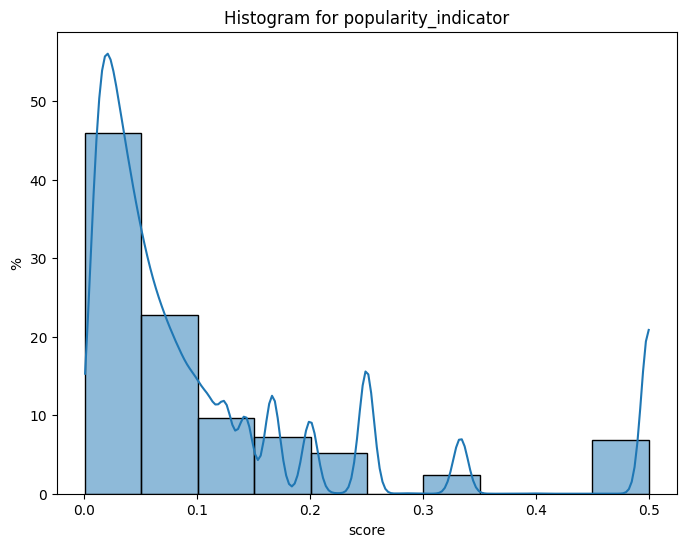

In [ ]:
plot_sns_histogram(df_article_popularity, 'popularity_indicator', x_title='score')

## 3.3. Séparation du jeu de donnée <a name="preparation-split">

### Pour les modèles de la librarie 'Surprise'

La préparation de données pour un système de recommandation utilisant la bibliothèque "Surprise" en trois étapes :   
1. __Création d'un objet "Reader"__ : La première étape consiste à créer un objet "Reader". Ce Reader est utilisé pour définir l'échelle des notations attendues dans l'ensemble de données. L'échelle des notations sera définie de 0 à 1, ce qui signifie que les notations des articles varieront de 0 (notation minimale) à 1 (notation maximale).  

2. __Chargement du jeu de données__ : Une fois que l'objet "Reader" est créé, l'ensemble de données réel est chargé à partir d'un DataFrame appelé "df_article_popularity". Ce DataFrame contient des informations sur la popularité des articles. La méthode "Dataset.load_from_df" est utilisée pour charger les données à partir de ce DataFrame en utilisant les paramètres définis dans le "Reader" (échelle de notation).

3. __Division de l'ensemble de données__ : Enfin, l'ensemble de données sera divisé en deux parties, à savoir un ensemble d'apprentissage (trainset) et un ensemble de test (testset). 20 % des données sont affectées à l'ensemble de test, tandis que les 80 % restants sont utilisés pour l'apprentissage du modèle.


In [ ]:
# Create a "Reader" object for defining the rating scale (minimum and maximum ratings)
reader = Reader(rating_scale=(0, 0.5))

# Load the dataset from the DataFrame df_article_popularity using the defined reader
dataset = Dataset.load_from_df(df_article_popularity, reader)

# Split the dataset into a training set and a test set, with 20% of the data in the test set
trainset, testset = train_test_split(dataset, test_size=.20)

### Pour les modèles de la librairie 'Implicit'

Ici, nous allons simplement diviser le DataFrame "df_article_popularity" en deux parties, où 80 % des données sont réservées pour l'apprentissage du modèle (df_train) et 20 % sont réservées pour tester la performance du modèle (df_test).  
Ensuite, nous allons créer des matrices CSR à partir des données d'apprentissage (df_train) et des données de test (df_test). Ces matrices sont essentielles pour des modèles de recommandation, comme les systèmes de filtrage collaboratif, ils utilisent ces matrices pour générer des recommandations personnalisées aux utilisateurs.

In [ ]:
df_train, df_test = sk_train_test_split(df_article_popularity, train_size=0.8, random_state=42)

dimentions = (max(df_train.user_id.max(), df_test.user_id.max()) + 1, max(df_train.click_article_id.max(), df_test.click_article_id.max()) + 1)

csr_train = csr_matrix((df_train['popularity_indicator'], (df_train['user_id'], df_train['click_article_id'])), dimentions)
csr_test = csr_matrix((df_test['popularity_indicator'], (df_test['user_id'], df_test['click_article_id'])), dimentions)

In [ ]:
csr_article_popularity = csr_matrix((df_article_popularity['popularity_indicator'], (df_article_popularity['user_id'], df_article_popularity['click_article_id'])), dimentions)
save_npz('/content/drive/MyDrive/Openclassroom/clean_data/csr_article_popularity.npz', csr_article_popularity)

# 4. Modélisation du système de recommandation <a name="modelisation">

Nous allons désormais explorer deux approches pour développer notre système de recommandation :

* Filtrage collaboratif (Collaborative Filtering) : Cette méthode repose sur l'idée que les utilisateurs ayant des préférences similaires ont tendance à apprécier les mêmes articles.

* Filtrage basé sur le contenu (Content-Based Filtering) : Cette méthode se base sur l'idée que des articles similaires ont tendance à plaire aux mêmes utilisateurs."

Pour évaluer la performance de nos modèles de recommandation, nous utiliserons quatre métriques différentes :

1. La __précision__ : Cette mesure évalue quelle proportion des articles recommandés est effectivement pertinente pour un utilisateur donné. Plus précisément, elle calcule le nombre d'articles pertinents parmi les recommandations, divisé par le nombre total d'articles recommandés.

2. Le __Mean Average Precision__ (MAP) : Le MAP évalue la qualité du classement des articles recommandés. Il calcule la précision moyenne sur toutes les positions de la liste de recommandations. Une caractéristique importante du MAP est qu'il tient compte des articles pertinents qui ne sont pas recommandés, les incluant dans le calcul de la précision moyenne. Cela permet de mesurer la qualité globale du classement.

3. Le __Normalized Discounted Cumulative Gain__ (NDCG) : Le NDCG évalue la qualité du classement des articles recommandés en considérant l'ordre de recommandation. Il prend en compte à la fois la pertinence de chaque article recommandé et sa position dans la liste de recommandations. Cela permet d'évaluer la qualité du classement en fonction de l'importance de la position de chaque article.

Ces trois métriques sont couramment utilisées pour évaluer les systèmes de recommandation, car elles évaluent à la fois la pertinence des recommandations et l'ordre dans lequel elles sont présentées.

En outre, compte tenu de la disponibilité des embeddings pour l'ensemble de nos articles, nous envisageons de créer une métrique basée sur leur similarité. Cette nouvelle métrique consisterait à comparer l'embedding moyen des articles lus avec l'embedding moyen des articles recommandés. Cela nous permettrait d'évaluer à quel point les sujets des articles recommandés correspondent à ceux qui ont été lus. Cependant, il est important de noter que cette métrique ne nous indiquera pas si les articles recommandés ont effectivement été lus par l'utilisateur, mais plutôt à quel point le contenu des articles recommandés est similaire à celui des articles lus.

In [ ]:
df_evaluation_results = pd.DataFrame(columns=('model', 'rmse', 'mse', 'mae'))
df_cb_evaluation_results = pd.DataFrame(columns=('model', 'mean_cos_similarity', 'precision', 'map', 'ndcg'))

## 4.1. Recommandation collaborative <a name="modelisation-colabo">

Dans cette partie la bibliothèque Implicit est utilisée pour la recommandation basée sur les préférences implicites des utilisateurs. Contrairement à la bibliothèque Surprise qui se concentre sur les données explicites (notes ou évaluations), Implicit se concentre sur les interactions implicites telles que les clics, les likes, les commentaires et les lectures. Cette librairie a été spécifiquement conçue pour les systèmes de recommandation utilisant des données implicites concernant le comportement des utilisateurs. Notre dataset ne contenant aucune note explicite sur les articles, nous allons utiliser cette librairie.

### AlternatingLeastSquares

Alternating Least Squares (ALS) est un algorithme couramment utilisé en filtrage collaboratif pour créer des systèmes de recommandation personnalisés. Cet algorithme vise à modéliser les préférences des utilisateurs et les caractéristiques des articles en optimisant une fonction de coût spécifique.

In [ ]:
als_model = AlternatingLeastSquares(
    factors=32,
    regularization=0.05,
    iterations=50,
    alpha=40
)

als_model.fit(csr_train)

  0%|          | 0/50 [00:00<?, ?it/s]

Utilisons notre modèle pour suggérer des articles à certains utilisateurs.

In [ ]:
user_ids = [15, 1005]
recommend_articles_to_users(als_model, user_ids, csr_test)


Recommended articles for the user 15

article_id:     336221 	 score: 0.5954748392105103
article_id:      95716 	 score: 0.5805308818817139
article_id:     293114 	 score: 0.5437114834785461
article_id:     124749 	 score: 0.5099532008171082
article_id:     293050 	 score: 0.44142603874206543

Recommended articles for the user 1005

article_id:     207122 	 score: 1.062351107597351
article_id:     284463 	 score: 0.929462730884552
article_id:     160474 	 score: 0.8740277886390686
article_id:     119592 	 score: 0.8510658740997314
article_id:      96663 	 score: 0.8010659217834473


__Evaluation du modèle AlternatingLeastSquares__

Evaluons à quel point les recommandations d'articles sont similaires aux articles déjà consultés par les utilisateurs. Pour cela on utilise des embeddings d'articles et la similarité cosinus pour mesurer cette similarité.

In [ ]:
mcs_score, df_mcs = calculate_user_recommendation_similarity(als_model, df_test, csr_train)

In [ ]:
df_mcs.head()

,viewed_articles,viewed_mean_embedding,recommended_articles,recommended_mean_embedding,cos_similarity
user_id,,,,,
0,"[87205, 160158]","[-0.03550847, -0.9476059, -0.07711148, 0.50052...","[293114, 124749, 284985, 70999, 293050]","[-0.25549108, -0.9683126, 0.06232536, -0.61962...",0.142912
1,"[59758, 160474, 156723]","[-0.1728301, -0.9610632, -0.60426974, -0.31189...","[207122, 233688, 111043, 160474, 284463]","[-0.43344396, -0.9675964, -0.40873498, -0.2046...",0.772007
3,"[234686, 236444, 120967, 235745, 233769, 23513...","[-0.6605651, -0.9666486, -0.36985785, -0.32376...","[124749, 96755, 272218, 158906, 160940]","[-0.5243417, -0.9739877, -0.27050003, -0.28154...",0.653041
5,"[161872, 158642, 65839, 59929, 225010, 50864, ...","[-0.1403337, -0.9585124, -0.15532371, -0.16229...","[160417, 300470, 158536, 162300, 166283]","[0.0726845, -0.9632244, -0.37215912, 0.2982656...",0.767633
6,"[313431, 235616, 234006, 156560, 203288, 70594]","[-0.18397911, -0.96323586, 0.05312494, -0.0874...","[199197, 156560, 156624, 276970, 124194]","[-0.06364801, -0.9702579, -0.053005964, -0.245...",0.627385


In [ ]:
df_mcs.describe()

,cos_similarity
count,115564.000000
mean,0.599892
std,0.161447
min,-0.347248
25%,0.497329
50%,0.618446
75%,0.718920
max,0.992452


In [ ]:
print(f'mean cosine similarity: {mcs_score}')

mean cosine similarity: 0.5998920798301697


In [ ]:
df_cb_evaluation_results = evaluate_model_and_append_to_df(als_model, csr_train, csr_test, 'AlternatingLeastSquares', df_cb_evaluation_results)

  0%|          | 0/210079 [00:00<?, ?it/s]

  0%|          | 0/210079 [00:00<?, ?it/s]

  0%|          | 0/210079 [00:00<?, ?it/s]

In [ ]:
add_mean_cos_similarity(df_cb_evaluation_results, 'AlternatingLeastSquares', mcs_score)
df_cb_evaluation_results

,model,mean_cos_similarity,precision,map,ndcg
0,AlternatingLeastSquares,0.599892,0.16775,0.12218,0.16145


### LogisticMatrixFactorization

Logistic Matrix Factorization (LMF) est une approche de filtrage collaboratif qui incorpore des éléments de modélisation probabiliste pour estimer les probabilités d'interaction entre les utilisateurs et les articles. Elle est utilisée pour générer des recommandations personnalisées en se basant sur des données implicites et des facteurs latents.

In [ ]:
lmf_model = LogisticMatrixFactorization(
    factors=32,
    learning_rate=0.05,
    regularization=0.05,
    iterations=50,
)

lmf_model.fit(csr_train)

  0%|          | 0/50 [00:00<?, ?it/s]

Utilisons notre modèle pour suggérer des articles à certains utilisateurs.

In [ ]:
user_ids = [15, 1005]
recommend_articles_to_users(lmf_model, user_ids, csr_test)


Recommended articles for the user 15

article_id:     341302 	 score: 14.193510055541992
article_id:     126036 	 score: 13.178346633911133
article_id:     155712 	 score: 11.922691345214844
article_id:     352575 	 score: 10.866579055786133
article_id:     184770 	 score: 10.66947078704834

Recommended articles for the user 1005

article_id:     208164 	 score: 11.093267440795898
article_id:     342629 	 score: 10.889937400817871
article_id:     250862 	 score: 10.264163970947266
article_id:     100209 	 score: 9.802064895629883
article_id:        638 	 score: 9.787567138671875


__Evaluation du modèle LogisticMatrixFactorization__

Evaluons à quel point les recommandations d'articles sont similaires aux articles déjà consultés par les utilisateurs. Pour cela on utilise des embeddings d'articles et la similarité cosinus pour mesurer cette similarité.

In [ ]:
mcs_score, df_mcs = calculate_user_recommendation_similarity(lmf_model, df_test, csr_train)
df_mcs.head()

,viewed_articles,viewed_mean_embedding,recommended_articles,recommended_mean_embedding,cos_similarity
user_id,,,,,
0,"[87205, 160158]","[-0.03550847, -0.9476059, -0.07711148, 0.50052...","[255718, 253056, 207061, 45306, 355575]","[0.07080595, -0.97567445, 0.3365957, 0.0454533...",0.294327
1,"[59758, 160474, 156723]","[-0.1728301, -0.9610632, -0.60426974, -0.31189...","[8006, 39757, 114853, 233595, 237533]","[-0.6104624, -0.96340466, 0.00889104, -0.26191...",0.504906
3,"[234686, 236444, 120967, 235745, 233769, 23513...","[-0.6605651, -0.9666486, -0.36985785, -0.32376...","[42618, 123716, 253692, 355001, 158083]","[-0.18965556, -0.95551413, -0.095221125, -0.08...",0.643413
5,"[161872, 158642, 65839, 59929, 225010, 50864, ...","[-0.1403337, -0.9585124, -0.15532371, -0.16229...","[19104, 236505, 152735, 357554, 68293]","[0.2583115, -0.9630847, -0.042553563, -0.13608...",0.794128
6,"[313431, 235616, 234006, 156560, 203288, 70594]","[-0.18397911, -0.96323586, 0.05312494, -0.0874...","[265021, 20279, 122303, 152133, 320184]","[-0.1691741, -0.95694983, -0.09796564, -0.4469...",0.581153


In [ ]:
df_mcs.describe()

,cos_similarity
count,115564.000000
mean,0.482006
std,0.134097
min,-0.281709
25%,0.392241
50%,0.488615
75%,0.578793
max,0.881818


In [ ]:
print(f'mean cosine similarity: {mcs_score}')

df_cb_evaluation_results = evaluate_model_and_append_to_df(lmf_model, csr_train, csr_test, 'LogisticMatrixFactorization', df_cb_evaluation_results)

mean cosine similarity: 0.4820064902305603


  0%|          | 0/210079 [00:00<?, ?it/s]

  0%|          | 0/210079 [00:00<?, ?it/s]

  0%|          | 0/210079 [00:00<?, ?it/s]

In [ ]:
add_mean_cos_similarity(df_cb_evaluation_results, 'LogisticMatrixFactorization', mcs_score)
df_cb_evaluation_results

,model,mean_cos_similarity,precision,map,ndcg
0,AlternatingLeastSquares,0.599892,0.16775,0.12218,0.16145
1,LogisticMatrixFactorization,0.482006,0.00018,0.00007,0.00012


### BayesianPersonalizedRanking

Bayesian Personalized Ranking (BPR) est un algorithme de filtrage collaboratif qui se concentre sur la création de recommandations de classement en se basant sur les préférences ordonnées des utilisateurs. Il est adapté aux ensembles de données avec des évaluations implicites et est utilisé pour classer les articles en fonction de leur pertinence pour les utilisateurs.

In [ ]:
bpr_model = BayesianPersonalizedRanking(
    factors=32,
    learning_rate=0.05,
    regularization=0.05,
    iterations=50,
)

bpr_model.fit(csr_train)

  0%|          | 0/50 [00:00<?, ?it/s]

Utilisons notre modèle pour suggérer des articles à certains utilisateurs.

In [ ]:
user_ids = [15, 1005]
recommend_articles_to_users(bpr_model, user_ids, csr_test)


Recommended articles for the user 15

article_id:      83903 	 score: 1.7514723539352417
article_id:     191330 	 score: 1.7251373529434204
article_id:      43023 	 score: 1.7217134237289429
article_id:     313082 	 score: 1.7120387554168701
article_id:     324576 	 score: 1.6923567056655884

Recommended articles for the user 1005

article_id:      43023 	 score: 1.538294792175293
article_id:     233605 	 score: 1.4517905712127686
article_id:     158047 	 score: 1.4335368871688843
article_id:     191330 	 score: 1.4301804304122925
article_id:     209723 	 score: 1.4191083908081055


__Evaluation du modèle BayesianPersonalizedRanking__

Evaluons à quel point les recommandations d'articles sont similaires aux articles déjà consultés par les utilisateurs. Pour cela on utilise des embeddings d'articles et la similarité cosinus pour mesurer cette similarité.

In [ ]:
mcs_score, df_mcs = calculate_user_recommendation_similarity(bpr_model, df_test, csr_train)
df_mcs.head()

,viewed_articles,viewed_mean_embedding,recommended_articles,recommended_mean_embedding,cos_similarity
user_id,,,,,
0,"[87205, 160158]","[-0.03550847, -0.9476059, -0.07711148, 0.50052...","[158047, 145166, 83534, 108856, 43023]","[-0.3018279, -0.9562321, -0.21481797, 0.216279...",0.487284
1,"[59758, 160474, 156723]","[-0.1728301, -0.9610632, -0.60426974, -0.31189...","[233470, 283505, 158047, 283796, 233605]","[-0.54491705, -0.96785897, -0.27313536, -0.543...",0.743795
3,"[234686, 236444, 120967, 235745, 233769, 23513...","[-0.6605651, -0.9666486, -0.36985785, -0.32376...","[234995, 236682, 237356, 106819, 235008]","[-0.7284622, -0.96100795, -0.17286043, -0.3892...",0.918791
5,"[161872, 158642, 65839, 59929, 225010, 50864, ...","[-0.1403337, -0.9585124, -0.15532371, -0.16229...","[162636, 107177, 284994, 65399, 283589]","[-0.10462594, -0.96303165, 0.11015308, -0.1375...",0.798567
6,"[313431, 235616, 234006, 156560, 203288, 70594]","[-0.18397911, -0.96323586, 0.05312494, -0.0874...","[206606, 236220, 208539, 15418, 205973]","[-0.4331388, -0.9666627, -0.036339432, 0.03536...",0.772858


In [ ]:
df_mcs.describe()

In [ ]:
print(f'mean cosine similarity: {mcs_score}')
model_name = 'BayesianPersonalizedRanking'

df_cb_evaluation_results = evaluate_model_and_append_to_df(bpr_model, csr_train, csr_test, model_name, df_cb_evaluation_results)

mean cosine similarity: 0.5833682417869568


  0%|          | 0/210079 [00:00<?, ?it/s]

  0%|          | 0/210079 [00:00<?, ?it/s]

  0%|          | 0/210079 [00:00<?, ?it/s]

In [ ]:
add_mean_cos_similarity(df_cb_evaluation_results, model_name, mcs_score)
df_cb_evaluation_results

,model,mean_cos_similarity,precision,map,ndcg
0,AlternatingLeastSquares,0.599892,0.16775,0.12218,0.16145
1,LogisticMatrixFactorization,0.482006,0.00018,0.00007,0.00012
2,BayesianPersonalizedRanking,0.583368,0.03759,0.02341,0.03317


### Comparaison des modèles

__Mean Cosine Similarity__ (mean_cos_similarity) : Cette métrique mesure la similarité moyenne entre les recommandations et les articles consultés par les utilisateurs. L'AlternatingLeastSquares a la valeur la plus élevée (0.6), indiquant une similarité plus élevée entre les recommandations et les articles consultés.

__Precision__ : Cette métrique évalue la proportion d'articles recommandés qui sont pertinents. L'AlternatingLeastSquares a la meilleure précision (0.17), mais la précision globale est relativement faible pour tous les modèles.

__MAP__ (Mean Average Precision) : Le MAP évalue la qualité du classement des articles recommandés. L'AlternatingLeastSquares a la meilleure valeur de MAP (0.12), indiquant un meilleur classement des articles pertinents.

__NDCG__ (Normalized Discounted Cumulative Gain) : Le NDCG évalue la qualité du classement des articles recommandés en prenant en compte l'ordre de la recommandation. L'AlternatingLeastSquares a la meilleure valeur de NDCG (0.16), ce qui signifie que les articles pertinents sont mieux classés dans les recommandations.

En fonction de ces métriques, l'__AlternatingLeastSquares__ semble être le meilleur modèle parmi les trois. Il présente la similarité moyenne la plus élevée, une meilleure précision, un MAP plus élevé, et un NDCG supérieur. Par conséquent, il serait judicieux de choisir l'AlternatingLeastSquares pour une utilisation dans l'application, car il semble offrir les meilleures performances en termes de recommandations d'articles pertinents pour les utilisateurs.

In [ ]:
als_model.save('/content/drive/MyDrive/Openclassroom/models/als_implicit_model.npz')

## 4.2. Recommandation basée sur le contenu <a name="modelisation-content">

Pour la recommandation basée sur le contenu j'ai créé une fonction nommée `recommend_content_based_articles`. Cette fonction recommande des articles à un utilisateur en se basant sur ses lectures récentes et inclut des articles non consultés. Elle prend en compte à la fois la similarité entre les articles et la nouveauté des articles pour fournir des recommandations personnalisées.  
Voici comment elle fonctionne sans entrer dans les détails techniques :

1. La fonction commence par obtenir les articles les plus récemment consultés par l'utilisateur en fonction de la valeur de `user_history_length`.

2. Elle sélectionne un certain nombre d'articles non consultés par l'utilisateur. Le nombre d'articles non consultés dépend de `num_recommendations` modulo 4, ce qui signifie que si num_recommendations est, par exemple, 7, il sélectionnera 3 articles non consultés.

3. Pour chaque article récemment consulté par l'utilisateur, la fonction recherche des articles similaires par rapport à l'article consulté. Ces articles similaires sont ensuite ajoutés au DataFrame des recommandations.

4. Un sous-ensemble aléatoire d'articles similaires est sélectionné à partir des recommandations. La taille de ce sous-ensemble dépend du nombre total de recommandations moins le nombre d'articles non consultés.

5. Enfin, la fonction ajoute les articles non consultés à la liste des recommandations. Ces articles non consultés ont un score de similarité de 0, car ils n'ont pas encore été lus par l'utilisateur.

6. La fonction renvoie la liste finale d'articles recommandés, qui sont une combinaison d'articles similaires aux articles récemment consultés et d'articles non consultés.

In [ ]:
content_based_recommendations = recommend_content_based_articles(df_article_popularity, 0, num_recommendations=5, user_history_length=5)
content_based_recommendations

,article_id,cos_similarity_score
0,311902,0.879880
1,160934,0.798336
2,313919,0.875059
3,313995,0.914393
4,225314,0.000000


On affiche ici cinq articles recommandés pour un utilisateur identifié par le numéro 0. Parmi ces cinq articles, quatre sont des recommandations basées sur le contenu des cinq articles les plus récemment consultés par l'utilisateur, tandis qu'un article est nouveau et n'a pas encore été consulté par aucun utilisateur.

## 4.3. Recommandations pour les nouveaux utilisateurs <a name="modelisation-new">

Pour un utilisateur qui n'a pas d'historique de clic, nous allons simplement lui recommander les articles ayant la somme des notes de popularité la plus élevée.

In [ ]:
top_articles = get_top_popular_articles(df_article_popularity, num_recommendations=5)
top_articles

Top 5 popular articles:


,article_id,score
0,160974,1.000000
1,272143,0.611836
2,123909,0.574888
3,162655,0.546721
4,234698,0.546504


## 4.4. Recommandation collaborative (bibliothèque Surprise) <a name="modelisation-surprise">

Nous explorerons le domaine de la recommandation collaborative en utilisant la bibliothèque "Surprise" (Simple Python RecommendatIon System Engine). La recommandation collaborative se base sur le principe que les utilisateurs partageant des préférences similaires ont tendance à apprécier les mêmes articles. Pour ce faire, nous mettrons en œuvre plusieurs modèles de filtrage collaboratif, chacun ayant ses propres caractéristiques et avantages.

La bibliothèque "Surprise" nous offre une gamme de modèles, dont __SVD__ (Singular Value Decomposition), __BaselineOnly__ et __CoClustering__, qui nous permettront d'explorer différentes approches pour prédire les notes en utilisant les données disponibles.

### SVD

In [ ]:
svd_model = SVD(n_factors=30, lr_all=0.02, reg_all=0.1)
svd_model.fit(trainset)
predictions = svd_model.test(testset)

In [ ]:
df_evaluation_results = add_evaluation_scores('SVD', predictions, df_evaluation_results)
df_evaluation_results

,model,rmse,mse,mae
0,SVD,0.182403,0.033271,0.15826


In [ ]:
recommended_articles = recommend_top_articles(svd_model, 15)
recommended_articles

Total articles viewed by the user 15: 7
Total articles not viewed by the user 15: 364040


,article_id,score
0,160974,0.439189
1,331116,0.427163
2,158536,0.423824
3,96210,0.423150
4,168623,0.422986
5,162655,0.422242
6,64329,0.421248
7,289090,0.421242
8,233688,0.418948
9,161178,0.418732


### BaselineOnly

In [ ]:
bonly_model = BaselineOnly()
bonly_model.fit(trainset)
predictions = bonly_model.test(testset)

Estimating biases using als...


In [ ]:
df_evaluation_results = add_evaluation_scores('BaselineOnly', predictions, df_evaluation_results)
df_evaluation_results

,model,rmse,mse,mae
0,SVD,0.182403,0.033271,0.158260
1,BaselineOnly,0.099663,0.009933,0.062118


In [ ]:
recommended_articles = recommend_top_articles(bonly_model, 15)
recommended_articles

Total articles viewed by the user 15: 7
Total articles not viewed by the user 15: 364040


,article_id,score
0,33549,0.279039
1,74501,0.276738
2,87144,0.270270
3,76000,0.269746
4,51624,0.266986
5,39186,0.265689
6,75999,0.259344
7,14394,0.258044
8,76216,0.251553
9,70187,0.250898


### CoClustering

In [ ]:
coclustering_model = CoClustering()
coclustering_model.fit(trainset)
predictions = coclustering_model.test(testset)

In [ ]:
df_evaluation_results = add_evaluation_scores('CoClustering', predictions, df_evaluation_results)
df_evaluation_results

,model,rmse,mse,mae
0,SVD,0.182403,0.033271,0.158260
1,BaselineOnly,0.099663,0.009933,0.062118
2,CoClustering,0.164610,0.027096,0.107410


In [ ]:
recommended_articles = recommend_top_articles(coclustering_model, 15)
recommended_articles

Total articles viewed by the user 15: 7
Total articles not viewed by the user 15: 364040


,article_id,score
0,0,0.109447
1,1,0.109447
2,2,0.109447
3,4,0.109447
4,5,0.109447
5,6,0.109447
6,7,0.109447
7,8,0.109447
8,9,0.109447
9,10,0.109447


# 5. Mise à jour des bases de données <a name="updatedata">

L'objectif principal de la mise à jour des bases de données utilisateurs et articles est de garantir que le système de recommandation puisse offrir des recommandations pertinentes et à jour aux utilisateurs.  
La fréquence de mise à jour des bases de données utilisateurs et articles peut varier en fonction des besoins de la plateforme, mais elle doit être régulière pour maintenir la qualité des recommandations. Elle peut être quotidienne, hebdomadaire ou en temps réel, selon la dynamique de la plateforme.

## 5.1. Gestion des articles <a name="update-articles">

__Besoins de mise à jour pour la base de données des articles__ :

1. __Ajout de nouveaux articles__ : Lorsque de nouveaux articles sont publiés ou ajoutés à la plateforme, ils doivent être intégrés à la base de données des articles.

2. __Mise à jour des informations d'articles__ : Les informations sur les articles, telles que les métadonnées, les catégories, les évaluations, et les interactions, doivent être régulièrement mises à jour pour refléter les changements et les évolutions.

3. __Suppression d'articles obsolètes__ : Les articles qui ne sont plus pertinents, obsolètes, ou qui ont été retirés de la plateforme doivent être supprimés de la base de données.

4. __Gestion des changements de disponibilité__ : Si un article devient indisponible ou est retiré de la plateforme, cette information doit être mise à jour dans la base de données pour éviter de recommander des articles qui ne peuvent pas être consultés.

In [ ]:
# Example usage
new_article_data = {
    'category_id': 3,
    'created_at_ts': 1635798000000,
    'publisher_id': 5,
    'words_count': 750
}

df_articles_metadata = add_new_article(df_articles_metadata, new_article_data)

df_articles_metadata.tail()

,article_id,category_id,created_at_ts,publisher_id,words_count
364043,364043,460,1434148472000,0,463
364044,364044,460,1457974279000,0,177
364045,364045,460,1515964737000,0,126
364046,364046,460,1505811330000,0,479
364047,364047,3,1635798000000,5,750


## 5.2. Gestion des utilisateurs <a name="update-users">

__Besoins de mise à jour pour la base de données des utilisateurs__ :

1. __Ajout de nouveaux utilisateurs__ : Lorsqu'un nouvel utilisateur s'inscrit ou rejoint la plateforme, son profil et ses préférences doivent être ajoutés à la base de données.

2. __Mise à jour des préférences__ : Les préférences des utilisateurs peuvent évoluer avec le temps. Il est donc nécessaire de permettre aux utilisateurs de mettre à jour leurs informations et préférences, et de refléter ces changements dans la base de données.

3. __Suppression de comptes__ : Les comptes d'utilisateurs inactifs ou désactivés doivent être supprimés de la base de données pour maintenir sa propreté et son efficacité.

# 6. Synthèse

La start-up My Content se lance dans le développement d'une application de recommandation de contenus axée sur la lecture. Les données d'interaction utilisateur avec des articles de Globo.com sont utilisées pour créer un système de recommandation. Les données sont riches, avec des millions de clics, impliquant des centaines de milliers d'utilisateurs et des milliers d'articles.

L'indicateur de popularité est créé pour modéliser les préférences implicites des utilisateurs. Les données sont divisées en ensembles d'apprentissage et de test, avec des matrices CSR générées pour les modèles de recommandation Implicit.

Nous avons exploré deux approches principales : le filtrage collaboratif et le filtrage basé sur le contenu. Chacune de ces méthodes présente ses avantages et ses limites, et nous avons utilisé des métriques telles que le MAP, le NDCG, la précision, et la similarité moyenne pour évaluer la performance des modèles.

Quatre métriques sont utilisées pour évaluer la performance des modèles. L'Alternating Least Squares (ALS) est choisi pour sa meilleure performance.

